# Ejercicio 9:

Tomar fotografías donde coexistan varios objetos en posiciones solapadas y no, en contextos de diferente complejidad.

Luego, aplicar los algoritmos de segmentación propuestos y verificar los resultados de cada uno.

Comentar qué diferencias observa.

In [ ]:
def imprimir_imagenes(imagenes, f=True):

  for nro, imagen in enumerate(imagenes.keys()):

    if nro == 0:
      # Configurar los subplots
      fig, axes = plt.subplots(len(imagenes.keys()), 2, figsize=(30, 20))

    # Mostrar la imagen original
    axes[nro,0].imshow(cv.cvtColor(imagenes[imagen][0], cv.COLOR_BGR2RGB), aspect='auto')
    axes[nro,0].set_title(f'"{imagen}" original')
    axes[nro,0].axis('off')  # Ocultar los ejes

    if f==True:
      # Mostrar la imagen segmentada
      axes[nro,1].imshow(cv.cvtColor(imagenes[imagen][1], cv.COLOR_BGR2RGB), aspect='auto')
      axes[nro,1].set_title(f'"{imagen}" segmentada')
      axes[nro,1].axis('off')  # Ocultar los ejes
    else:
      # Mostrar la imagen segmentada
      axes[nro,1].imshow(imagenes[imagen][1], aspect='auto')
      axes[nro,1].set_title(f'"{imagen}" segmentada')
      axes[nro,1].axis('off')  # Ocultar los ejes

    if nro == ( len(imagenes.keys())-1 ):
      # Mostrar ambas imágenes
      plt.show()

## Semantic Segmentation (Segmentacion Semantica):

### Con DeepLabV3 (Torchvision):

Modelo: https://pytorch.org/vision/main/models/generated/torchvision.models.segmentation.deeplabv3_resnet50.html

In [ ]:
%%capture
!pip install torchvision
import torch
model = torch.hub.load('pytorch/vision:v0.10.0', 'deeplabv3_resnet50', pretrained=True)
model.eval()

In [ ]:
from PIL import Image
import matplotlib.pyplot as plt
from torchvision import transforms
import torch
import cv2 as cv

In [ ]:
imagenes_deep_lab_v3 = {'5ta_avenida.jpeg': [], 'auto_personas.jpg': [], 'camioneta_helicoptero.jpg': []}

for imagen in imagenes_deep_lab_v3.keys():
  # Carga y procesa la imagen
  input_image = Image.open(imagen).convert("RGB").convert("RGB")

  preprocess = transforms.Compose([
      transforms.ToTensor(),
      transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
  ])

  input_tensor = preprocess(input_image)
  input_batch = input_tensor.unsqueeze(0)  # crea un mini-batch como espera el modelo

  # Mueve el input y el modelo a GPU para mayor velocidad si está disponible
  if torch.cuda.is_available():
      input_batch = input_batch.to('cuda')
      model.to('cuda')

  with torch.no_grad():
      output = model(input_batch)['out'][0]
  output_predictions = output.argmax(0)

  # Crea una paleta de colores, seleccionando un color para cada clase
  palette = torch.tensor([2 ** 25 - 1, 2 ** 15 - 1, 2 ** 21 - 1])
  colors = torch.as_tensor([i for i in range(21)])[:, None] * palette
  colors = (colors % 255).numpy().astype("uint8")

  # Genera la imagen de segmentación semántica
  r = Image.fromarray(output_predictions.byte().cpu().numpy()).resize(input_image.size)
  r.putpalette(colors)

  imagenes_deep_lab_v3[imagen].append(cv.cvtColor(np.array(input_image), cv.COLOR_RGB2BGR))
  imagenes_deep_lab_v3[imagen].append(np.array(r))

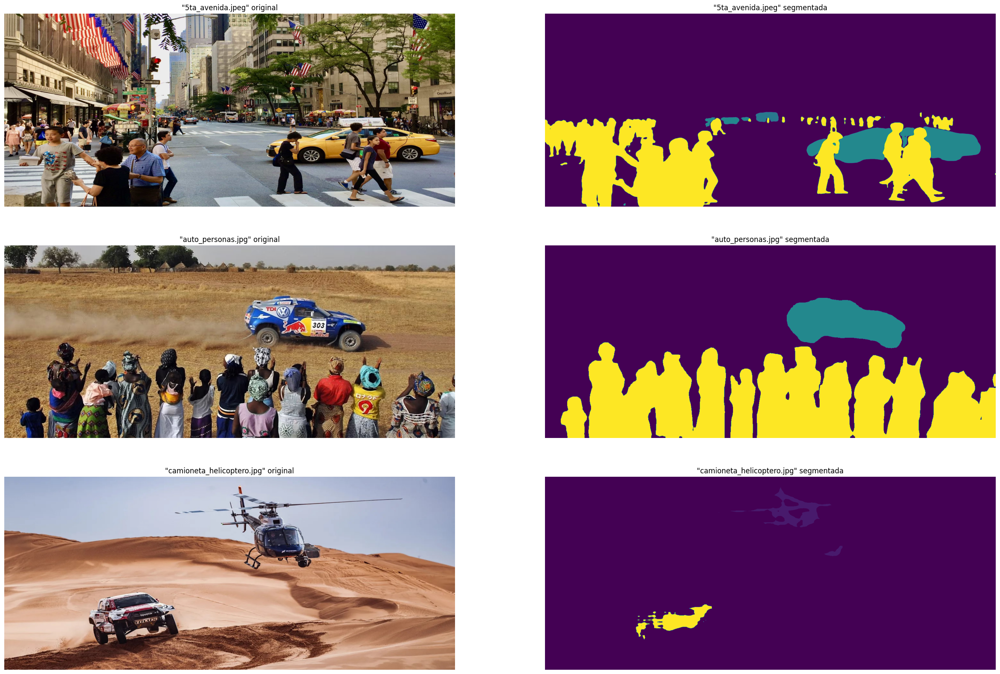

In [ ]:
imprimir_imagenes(imagenes_deep_lab_v3, f=False)

#### Resultados:

- Detecto bastante bien personas y autos en las primeras dos imagenes.

- En la ultima diferencia entre dos tipos de clases pero las mascaras estan incompletas.

## Instance Segmentation (Segmentacion de Instancias):

In [ ]:
segmentacion_instancias = {}

###  Con Mask R-CNN (OpenCV):

Descarga de modelo y archivos necesarios para poder utilizarlo:

In [ ]:
%%capture
!wget http://download.tensorflow.org/models/object_detection/mask_rcnn_inception_v2_coco_2018_01_28.tar.gz
!tar zxvf mask_rcnn_inception_v2_coco_2018_01_28.tar.gz
!wget https://raw.githubusercontent.com/spmallick/learnopencv/master/Mask-RCNN/mscoco_labels.names -O mscoco_labels.names
!wget https://raw.githubusercontent.com/spmallick/learnopencv/master/Mask-RCNN/colors.txt -O colors.txt
!wget https://raw.githubusercontent.com/spmallick/learnopencv/master/Mask-RCNN/mask_rcnn_inception_v2_coco_2018_01_28.pbtxt -O mask_rcnn_inception_v2_coco_2018_01_28.pbtxt

Preparacion del modelo para inferencia:

In [ ]:
import numpy as np
import cv2 as cv
import time
import random
from matplotlib import pyplot as plt

# Umbral de confianza para las detecciones
confThreshold = 0.5

# Umbral para las máscaras de segmentación
maskThreshold = 0.3

# Cargar los nombres de las clases de MSCOCO
classesFile = "mscoco_labels.names"
classes = None
with open(classesFile, 'rt') as f:
    classes = f.read().rstrip('\n').split('\n')

# Cargar los colores para visualizar las detecciones
colorsFile = "colors.txt"
colors = []
with open(colorsFile, 'rt') as f:
    colorsStr = f.read().rstrip('\n').split('\n')
    for i in range(len(colorsStr)):
        rgb = colorsStr[i].split(' ')
        color = np.array([float(rgb[0]), float(rgb[1]), float(rgb[2])])
        colors.append(color)

# Archivos de configuración y pesos del modelo Mask R-CNN
textGraph = "./mask_rcnn_inception_v2_coco_2018_01_28.pbtxt"
modelWeights = "./mask_rcnn_inception_v2_coco_2018_01_28/frozen_inference_graph.pb"

# Cargar la red
net = cv.dnn.readNetFromTensorflow(modelWeights, textGraph)
net.setPreferableBackend(cv.dnn.DNN_BACKEND_OPENCV)
net.setPreferableTarget(cv.dnn.DNN_TARGET_CPU)

In [ ]:
# Diccionario donde se van a guardar tanto la imagen cargada como las masks y boxes
imagenes_m_r_cnn = {'5ta_avenida.jpeg': [], 'auto_personas.jpg': [], 'camioneta_helicoptero.jpg': []}

# Iteramos cada imagen del diccionario:
for imagen in imagenes_m_r_cnn.keys():

  # Cargar la imagen para luego calcular los boxes y las mascaras
  image = cv.imread(imagen)

  # Crear un blob de la imagen y realizar una pasada hacia adelante con Mask R-CNN
  blob = cv.dnn.blobFromImage(image, swapRB=True, crop=False)
  net.setInput(blob)
  start = time.time()
  (boxes, masks) = net.forward(["detection_out_final", "detection_masks"])
  end = time.time()

  imagenes_m_r_cnn[imagen].append(image)
  imagenes_m_r_cnn[imagen].append((boxes, masks))

  # Información de tiempo y formas de las detecciones y máscaras
  print(f"Imagen: {imagen}")
  print("[INFO] Mask R-CNN tomó {:.2f} segundos en procesar la imagen".format(end - start))
  print("[INFO] Forma de boxes: {}".format(boxes.shape))
  print("[INFO] Forma de masks: {}".format(masks.shape))
  print('---------------------------------------------------------------')


Imagen: 5ta_avenida.jpeg
[INFO] Mask R-CNN tomó 10.72 segundos en procesar la imagen
[INFO] Forma de boxes: (1, 1, 100, 7)
[INFO] Forma de masks: (100, 90, 15, 15)
---------------------------------------------------------------
Imagen: auto_personas.jpg
[INFO] Mask R-CNN tomó 5.25 segundos en procesar la imagen
[INFO] Forma de boxes: (1, 1, 100, 7)
[INFO] Forma de masks: (100, 90, 15, 15)
---------------------------------------------------------------
Imagen: camioneta_helicoptero.jpg
[INFO] Mask R-CNN tomó 6.51 segundos en procesar la imagen
[INFO] Forma de boxes: (1, 1, 100, 7)
[INFO] Forma de masks: (100, 90, 15, 15)
---------------------------------------------------------------


Visualización de máscaras y bounding boxes

In [ ]:
for imagen in imagenes_m_r_cnn.keys():

  # Cargo los boxes y masks guardados
  boxes, masks = imagenes_m_r_cnn[imagen][1]

  # Cargo la imagen
  image = imagenes_m_r_cnn[imagen][0]

  # Obtengo sus dimensiones
  (H, W) = image.shape[:2]

  # Copia de la imagen original, para dibujar las máscaras
  output_image = image.copy()

  for i in range(0, boxes.shape[2]):
      confidence = boxes[0, 0, i, 2]
      if confidence > confThreshold:
          classId = int(boxes[0, 0, i, 1])
          box = boxes[0, 0, i, 3:7] * np.array([W, H, W, H])
          (startX, startY, endX, endY) = box.astype("int")

          # Redimensiona la máscara para que se ajuste a la caja delimitadora y la convierte en uint8
          mask = masks[i, classId]
          mask = cv.resize(mask, (endX - startX, endY - startY))
          mask = (mask > maskThreshold).astype("uint8")

          # Extrae la región de interés (ROI) usando las coordenadas de la caja delimitadora
          roi = output_image[startY:endY, startX:endX]

          # Crea una imagen de color sólido para la máscara
          color = random.choice(colors)
          color_mask = np.zeros_like(roi)
          color_mask[mask == 1] = color

          # Mezcla la imagen de color con la ROI utilizando la máscara
          roi = cv.addWeighted(roi, 1, color_mask, 0.4, 0)

          # Vuelve a colocar la ROI en la imagen original
          output_image[startY:endY, startX:endX] = roi

          # Dibuja la caja delimitadora
          cv.rectangle(output_image, (startX, startY), (endX, endY), color, 2)

          # Consigue el nombre de la clase y el color correspondiente
          classId = int(boxes[0, 0, i, 1])
          className = classes[classId]

          # Dibuja el rectángulo de la caja delimitadora y la etiqueta de la clase
          label = f"{className[0:4]}:{confidence:.2f}"
          cv.rectangle(output_image, (startX, startY), (endX, endY), color, 2)
          cv.putText(output_image, label, (startX, startY - 5), cv.FONT_HERSHEY_SIMPLEX, 1.6, color, 2)

  imagenes_m_r_cnn[imagen].insert(1, output_image)

In [ ]:
segmentacion_instancias['mask_r_cnn'] = imagenes_m_r_cnn

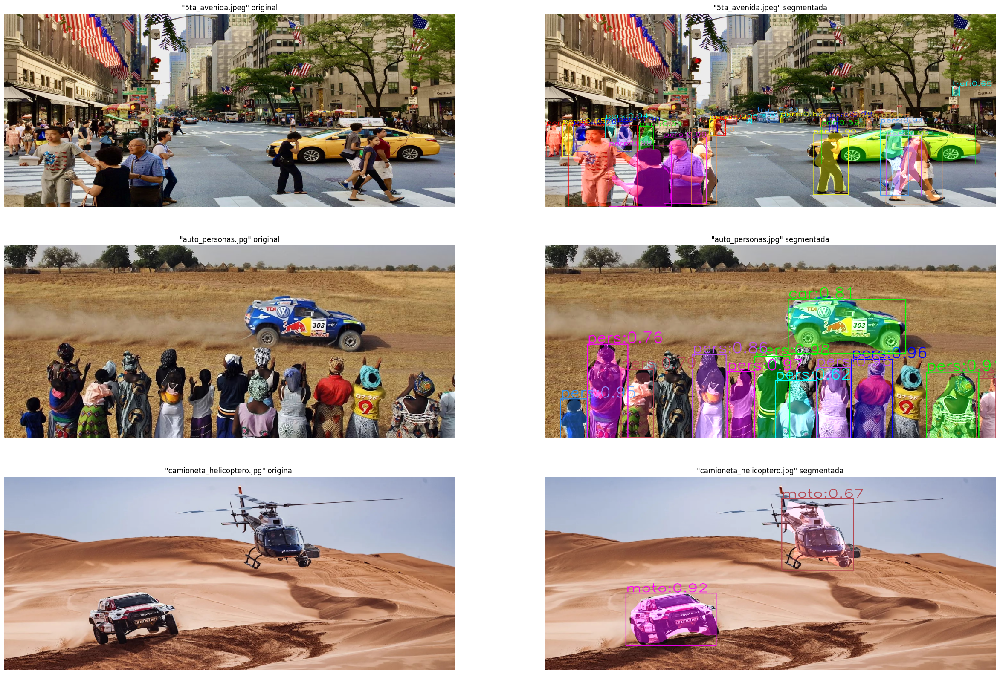

In [ ]:
imprimir_imagenes(imagenes_m_r_cnn)

#### Resultados:

- Nuevamente funciono muy bien en las primeras dos imagenes.

- En la ultima imagen diferencio entre los dos objetos pero los clasifico como moto.

### Instance Segmentation con modelo PointRend Resnet50 (PixelLib)

Fuente: https://github.com/ayoolaolafenwa/PixelLib/blob/master/Tutorials/Pytorch_image_instance_segmentation.md

Preparación de librerías e imágenes de prueba

In [ ]:
%%capture
!pip install pixellib torchvision
# Instance segmentation model
!wget "https://github.com/ayoolaolafenwa/PixelLib/releases/download/0.2.0/pointrend_resnet50.pkl" -O pointrend_resnet50.pkl
# !pip install Pillow==9.4.0

Carga de librerias y preparacion del modelo

In [ ]:
# Importación de las bibliotecas necesarias
import pixellib
from pixellib.torchbackend.instance import instanceSegmentation
from IPython.display import Image
import cv2 as cv
from matplotlib import pyplot as plt

# Creación de una instancia del modelo de segmentación
ins = instanceSegmentation()

# Carga del modelo preentrenado
ins.load_model("pointrend_resnet50.pkl")

  proposal_generator.anchor_generator.cell_anchors.{0, 1, 2, 3, 4}


Inferencia del modelo

In [ ]:
imagenes_point_red = {'5ta_avenida.jpeg': [], 'auto_personas.jpg': [], 'camioneta_helicoptero.jpg': []}

for imagen in imagenes_point_red.keys():

  # Segmentación de la imagen y guardado de la imagen segmentada con las cajas delimitadoras
  ins.segmentImage(imagen, show_bboxes=True, output_image_name=f"{imagen[:-5]}_segmented.jpeg")

  # Cargar la imagen para luego calcular los boxes y las mascaras
  image = cv.imread(imagen)
  imagenes_point_red[imagen].append(image)

  output_image = cv.imread(f"{imagen[:-5]}_segmented.jpeg")
  imagenes_point_red[imagen].append(output_image)

/usr/local/lib/python3.10/dist-packages/torch/functional.py:507: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3549.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


In [ ]:
segmentacion_instancias['pointrend'] = imagenes_point_red

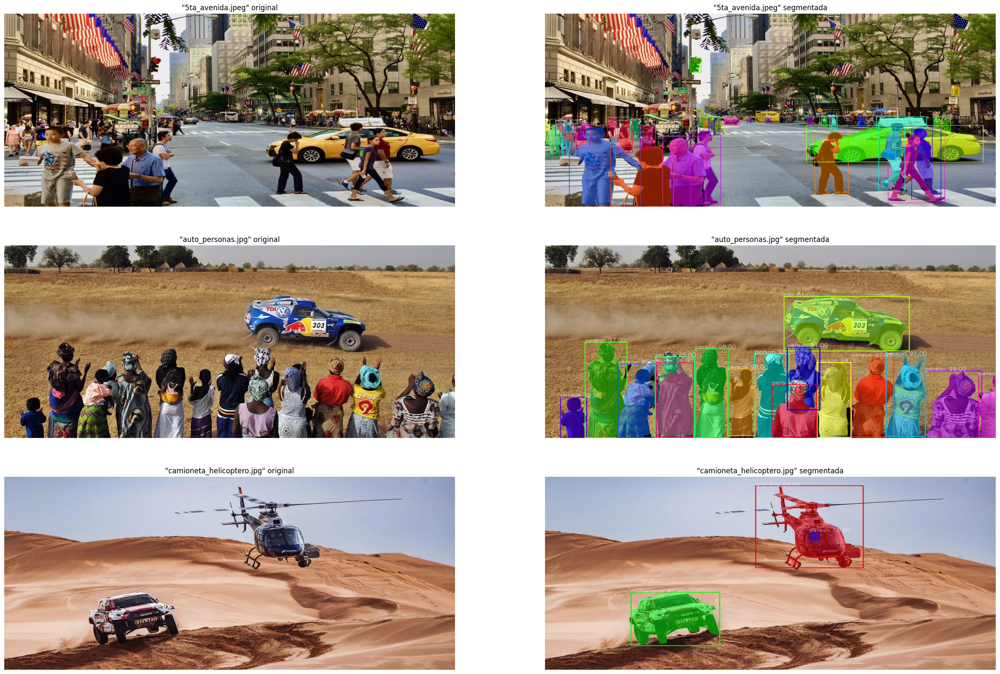

In [ ]:
imprimir_imagenes(imagenes_point_red)

#### Resultados:

- Muy similar al anterior caso en las primeras dos imagenes, mejora en cuanto a que reconoce mas clases.

- Mismo problema en la ultima foto. Reconoce mal las clases. Punto a favor que reconoce a la persona del helicoptero.

### Instance Segmentation con YoloV8 (Ultralytics)

Preparación de librerías necesarias y datos de prueba

In [ ]:
%%capture
!pip install ultralytics==8.0.196
# !pip install --upgrade pillow

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

!wget 'https://ultralytics.com/images/bus.jpg' -O bus.jpg

Inferencia y graficación de máscarasy bounding boxes

In [ ]:
from ultralytics import YOLO
from PIL import Image, ImageDraw, ImageChops, ImageFont
import numpy as np
from IPython.display import display
import cv2 as cv
from matplotlib import pyplot as plt

# Cargar el modelo YOLOv8 con capacidad de segmentación
model = YOLO("yolov8m-seg.pt")

100%|██████████| 52.4M/52.4M [00:00<00:00, 199MB/s]


In [ ]:
imagenes_yolo_v8 = {'5ta_avenida.jpeg': [], 'auto_personas.jpg': [], 'camioneta_helicoptero.jpg': []}

for imagen in imagenes_yolo_v8.keys():

  # Realizar predicciones en la imagen
  results = model.predict(imagen)

  # Seleccionar el primer resultado (en caso de que haya varios)
  result = results[0]

  # Abrir la imagen original para dibujar sobre ella
  img = Image.open(imagen)
  draw = ImageDraw.Draw(img)

  # Para cada detección, dibujar el bounding box y mostrar la clase
  for box in results[0].boxes:
      # Extracción de coordenadas del bounding box y clase
      x1, y1, x2, y2, conf, cls = box.data[0]
      label = result.names[int(cls)]  # Asumiendo que result.names contiene los nombres de las clases

      # Dibujar el bounding box
      draw.rectangle([x1, y1, x2, y2], outline=(0, 255, 0), width=2)

      # Mostrar la clase (y opcionalmente la confianza) en el bounding box
      text = f"{label} {conf:.2f}"
      draw.text((x1, y1-25), text, fill=(0, 255, 0), stroke_width=1, font_size=15)

  # Acceder a las máscaras del resultado
  masks = result.masks

  # Iterar a través de todas las máscaras encontradas
  for mask in masks:
      # Convertir la máscara a un array numpy y obtener el polígono
      mask_data = mask.data[0].numpy()
      polygon = mask.xy[0]

      # Dibujar el polígono correspondiente a cada máscara en la imagen original
      polygon_list = [(p[0], p[1]) for p in polygon]
      draw.polygon(polygon_list, outline=(255, 0, 0), width=3)

  # Convierte la imagen pillow a arreglo de NumPy y luego a un formato compatible con OpenCV
  output_image = cv.cvtColor(np.array(img), cv.COLOR_RGB2BGR)

  # Cargar la imagen para luego calcular los boxes y las mascaras
  image = cv.imread(imagen)
  imagenes_yolo_v8[imagen].append(image)

  imagenes_yolo_v8[imagen].append(output_image)

In [ ]:
segmentacion_instancias['yolo_v8'] = imagenes_yolo_v8

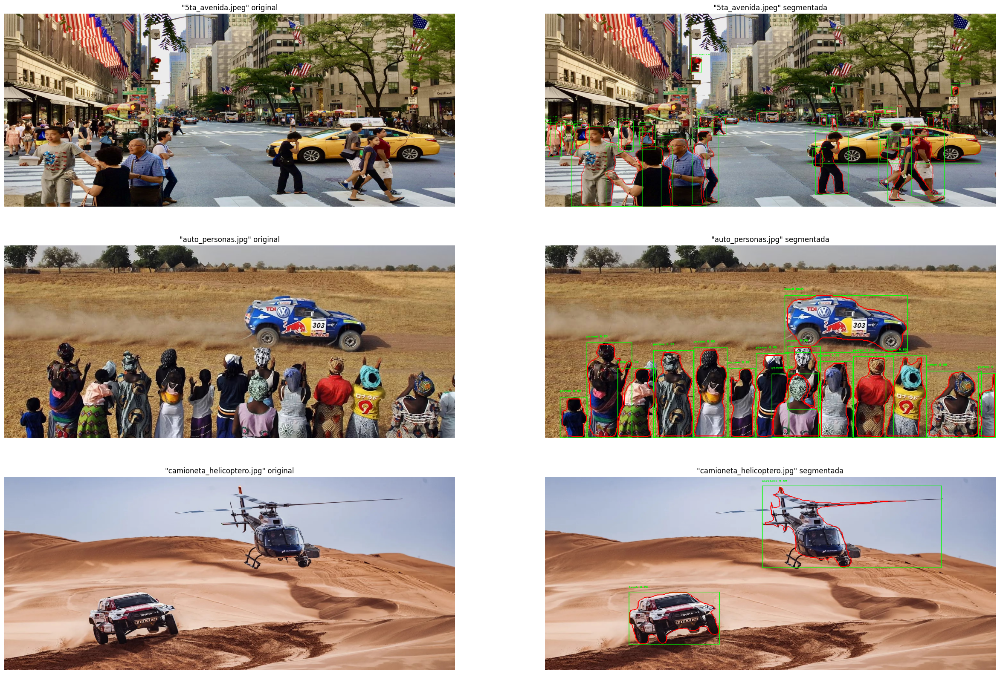

In [ ]:
imprimir_imagenes(imagenes_yolo_v8)

#### Resultados:

- Resultados muy similares al anterior caso.

- En la ultima imagen se reconocio bastante bien las clases, el helicoptero como airplane y la camioneta como truck.

### Comparacion de los resultado de los 3 metodos:

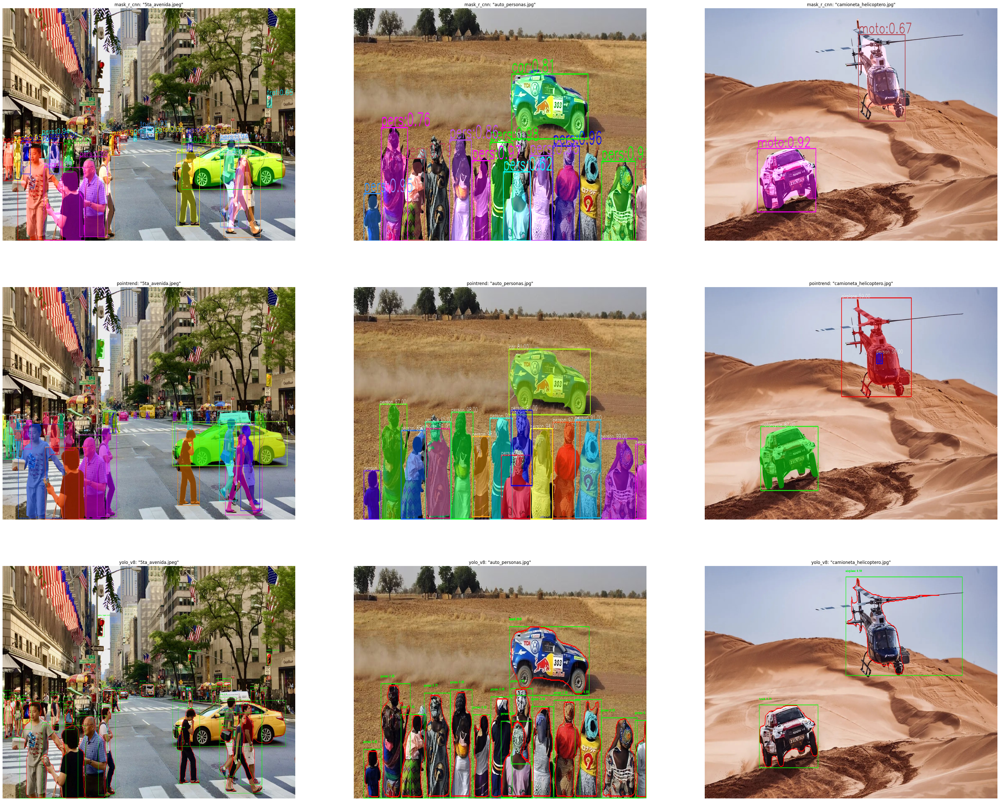

In [ ]:
for nro, algoritmo in enumerate(segmentacion_instancias.keys()):

  if nro == 0:
    # Configurar los subplots
    fig, axes = plt.subplots(len(segmentacion_instancias.keys()), 3, figsize=(50, 40))

  for nro2, imagen in enumerate(segmentacion_instancias['yolo_v8'].keys()):

    # Mostrar la imagen original
    axes[nro,nro2].imshow(cv.cvtColor(segmentacion_instancias[algoritmo][imagen][1], cv.COLOR_BGR2RGB), aspect='auto')
    axes[nro,nro2].set_title(f'{algoritmo}: "{imagen}"')
    axes[nro,nro2].axis('off')  # Ocultar los ejes

  if nro == ( len(segmentacion_instancias.keys())-1 ):
    # Mostrar ambas imágenes
    plt.show()

#### Resultados:

- Para la primera imagen los resultados en los 3 casos son muy similares. PointRend y Yolo tienen a favor que detectan mas clases como paraguas y detectan mas objetos del tipo semaforo.

- Para la segunda imagen ningun algoritmo detecta los niños que llevan en espalda las mujeres. Mask R CNN directamente no detecta una mujer. PointRend detecta dos personas en la 4ta posicion donde en realidad solo hay una. Yolo fue el que mejor funciono para este caso.

- Para la ultima imagen el unico que detecto bien las clases fue Yolo por lo que se prefiere este ultimo

- En conclusion: evaluando solo con estas imagenes se prefiere Yolo ya que fue el que mejor funciono.

## Panoptic Segmentation (Segmentacion Panoptica):

### Con modelo DETR ResNet50 (Transformers):

Modelo: https://huggingface.co/facebook/detr-resnet-50-panoptic

In [ ]:
%%capture
!pip install timm # Atencion reiniciar runtime luego de instalar para que funcione

In [ ]:
import io
import requests
from PIL import Image, ImageDraw, ImageFont
import torch
import numpy as np
import matplotlib.pyplot as plt
import itertools
import seaborn as sns
from transformers import DetrFeatureExtractor, DetrForSegmentation
from transformers.models.detr.feature_extraction_detr import rgb_to_id
import cv2 as cv

In [ ]:
# Cargar el modelo y el extractor de características
feature_extractor = DetrFeatureExtractor.from_pretrained("facebook/detr-resnet-50-panoptic")
model = DetrForSegmentation.from_pretrained("facebook/detr-resnet-50-panoptic")

In [ ]:
imagenes_detr = {'5ta_avenida.jpeg': [], 'auto_personas.jpg': [], 'camioneta_helicoptero.jpg': []}

for imagen in imagenes_detr.keys():

  # Cargar la imagen
  image = Image.open(imagen)

  # Preparar la imagen para el modelo
  inputs = feature_extractor(images=image, return_tensors="pt")

  # Paso forward
  outputs = model(**inputs)

  # Postprocesamiento
  processed_sizes = torch.as_tensor(inputs["pixel_values"].shape[-2:]).unsqueeze(0)
  result = feature_extractor.post_process_panoptic(outputs, processed_sizes, threshold=0.85)[0]

  # Convertir la segmentación a numpy
  panoptic_seg = Image.open(io.BytesIO(result["png_string"]))
  panoptic_seg = np.array(panoptic_seg, dtype=np.uint8)
  panoptic_seg_id = rgb_to_id(panoptic_seg)

  # Preparar la paleta de colores
  palette = itertools.cycle(sns.color_palette())

  # Crear la imagen segmentada
  segmented_image = Image.fromarray(np.zeros_like(panoptic_seg, dtype=np.uint8))
  draw = ImageDraw.Draw(segmented_image)

  # Añadimos un mapeo manual de los IDs de las categorías a los nombres, basado en las clases comunes de COCO
  COCO_LABELS = {
      1: 'persona', 2: 'bicicleta', 3: 'coche', 4: 'motocicleta', 5: 'avión',
      6: 'autobús', 7: 'tren', 8: 'camión', 9: 'barco', 10: 'semáforo',
      11: 'hidrante', 13: 'señal de stop', 14: 'parquímetro', 15: 'banco', 16: 'pájaro',
      17: 'gato', 18: 'perro', 19: 'caballo', 20: 'oveja', 21: 'vaca',
      22: 'elefante', 23: 'oso', 24: 'cebra', 25: 'jirafa', 27: 'mochila',
      28: 'paraguas', 31: 'bolso de mano', 32: 'corbata', 33: 'maleta', 34: 'frisbee',
      36: 'tabla de snowboard', 37: 'pelota deportiva', 38: 'cometa', 39: 'bate de béisbol',
      40: 'guante de béisbol', 41: 'patineta', 42: 'tabla de surf', 43: 'raqueta de tenis',
      44: 'botella', 46: 'plato de vino', 47: 'taza', 48: 'tenedor', 49: 'cuchillo',
      50: 'cuchara', 51: 'tazón', 52: 'banana', 53: 'manzana', 54: 'sándwich',
      55: 'naranja', 56: 'brócoli', 57: 'zanahoria', 58: 'perrito caliente', 59: 'pizza',
      60: 'donut', 61: 'pastel', 62: 'silla', 63: 'sofá', 64: 'maceta', 65: 'cama',
      67: 'mesa de comedor', 70: 'inodoro', 72: 'TV', 73: 'computadora portátil', 74: 'ratón',
      75: 'control remoto', 76: 'teclado', 77: 'teléfono celular', 78: 'microondas',
      79: 'horno', 80: 'tostadora', 81: 'fregadero', 82: 'refrigerador', 84: 'libro',
      85: 'reloj', 86: 'florero', 87: 'tijeras', 88: 'oso de peluche', 89: 'secador de pelo',
      90: 'cepillo de dientes',
  }

  # Ajusta el bucle para dibujar segmentos y etiquetas correctamente
  for segment_info in result["segments_info"]:
      class_id = segment_info["category_id"]
      class_name = COCO_LABELS.get(class_id, 'Desconocido')  # 'Desconocido' si el ID no está en el diccionario
      id = segment_info["id"]

      # Generar la máscara para este segmento específico
      mask = panoptic_seg_id == id
      color = np.array(next(palette)) * 255  # Convertir el color a un array de numpy adecuado

      # Convertir la máscara a una imagen de PIL para usarla como máscara en 'paste'
      mask_image = Image.fromarray((mask * 255).astype(np.uint8))

      # Crear una imagen del color del segmento que tenga las dimensiones correctas
      color_image = Image.new("RGB", segmented_image.size, color=tuple(color.astype(int)))

      # Pegar usando la máscara para aplicar solo este segmento
      segmented_image.paste(color_image, (0,0), mask=mask_image)

      # Dibujar el nombre de la clase en la posición inicial del segmento
      draw = ImageDraw.Draw(segmented_image)
      where = np.where(mask)
      if where[0].size > 0 and where[1].size > 0:
          x, y = np.min(where[1]), np.min(where[0])
          draw.text((x, y), class_name, fill='white')

  imagenes_detr[imagen].append(cv.cvtColor(np.array(image), cv.COLOR_RGB2BGR))
  imagenes_detr[imagen].append(cv.cvtColor(np.array(segmented_image), cv.COLOR_RGB2BGR))

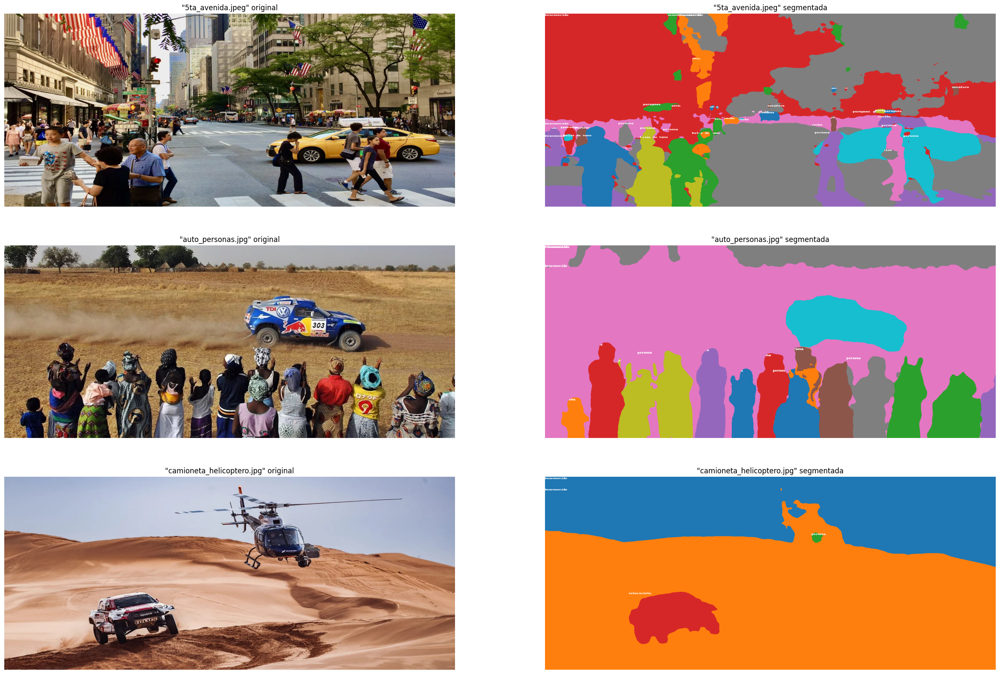

In [ ]:
imprimir_imagenes(imagenes_detr)

#### Resultados:

- Con DETR no se observaron resultados muy favorables para niguna de las imagenes.